 # Final assignment: Applied Data Science capstone
 ## 'The Battle of the Neighbourhoods' - B Kim

## Part 2 of assignment: island's demographic and tourism stats

In [2]:
# Import all libraries needed for this Notebook.
import numpy as np
import pandas as pd 
import json 
import requests
from pandas.io.json import json_normalize
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
import folium
import seaborn as sns
import math
print('Done importing libraries.')

Done importing libraries.


In [4]:
# From ISTAC we are able to obtain the geojson data for the districts in Gran Canaria.
# Notebook file exceeds size limit for GitHub. The 'geodata' has been removed from the stored memory, but can be  
# re-loaded running the requests.get link.
response = []
#response = requests.get("https://datos.canarias.es/catalogos/estadisticas/dataset/1f8a16e1-11dc-4bb1-8d6b-3ce1c3328b48/resource/b6ac49c7-c038-48af-b62b-4f0d9dd3846c/download/distritos_20170101.json")
#geodata = json.loads(response.text)

In [5]:
# Let's display the geodata to understand the structure and labels used.
geodata = []
#geodata

In [4]:
# The demography per district can be downloaded from ISTAC as well.
demographyDistricts = pd.read_csv('https://datos.canarias.es/catalogos/estadisticas/dataset/1f8a16e1-11dc-4bb1-8d6b-3ce1c3328b48/resource/d9276009-febf-4ef4-9e9f-14aaf2877679/download/20170101_indicadores_demograficos_pmh_distysecc.csv')

# Similar to Part 1, we need to filter the information so that we only obtain districts 
# within Gran Canaria.
demographyDistricts = demographyDistricts.loc[demographyDistricts['gcd_isla'] == 'ES705'].reset_index(drop=True)
demographyDistricts = demographyDistricts.loc[demographyDistricts['granularidad'] == 'DISTRITOS'].reset_index(drop=True)

In [5]:
# 'demographyDistricts' contains many many columns, but we are only interested in seeing
# the average age of inhabitants per municipality, and the ratio of foreign population.
demogDistrShort = pd.DataFrame(columns = ['district', 'population', 'meanAge', 'ratioForeignPop'])
demogDistrShort['district'] = demographyDistricts['geocode']
demogDistrShort['population'] = demographyDistricts['poblacion']
demogDistrShort['meanAge'] = demographyDistricts['poblacion_edad_media']
demogDistrShort['ratioForeignPop'] = demographyDistricts['poblacion_extranjera_pc']
demogDistrShort.head()

,district,population,meanAge,ratioForeignPop
0,20170101_35001_D01,5526,44.9,4.7
1,20170101_35002_D01,30882,39.1,5.4
2,20170101_35005_D01,1096,50.4,0.5
3,20170101_35006_D01,7542,42.4,2.1
4,20170101_35006_D02,2922,45.4,1.2


In [18]:
# Let's bring back the map of Gran Canaria plotted in Part 1.
# This time, we will plot a thematic map, that will represent the mean age and the
# ratio of foreign population per municipality, using the dataframe 'demogDistrShort'.
mapGC = folium.Map(location=[28.00, -15.65], tiles = 'Stamen Terrain', zoom_start=10)

# For plotting average age of inhabitants:
# threshold_scale = np.linspace(demogDistrShort['meanAge'].min(),
#                               demogDistrShort['meanAge'].max(),
#                               6, dtype=int)
# threshold_scale = threshold_scale.tolist() 
# threshold_scale[-1] = threshold_scale[-1] + 1

# mapGC.choropleth(
#     geo_data=geodata,
#     data=demogDistrShort,
#     columns=["district", "meanAge"],
#     key_on="feature.properties.geocode",
#     threshold_scale=threshold_scale,
#     fill_color='BuPu', 
#     fill_opacity=0.9, 
#     line_opacity=0.2,
#     legend_name='Mean age',
#     reset=True
# )

# For plotting ratio of foreign population:
threshold_scale = np.linspace(demogDistrShort['ratioForeignPop'].min(),
                              demogDistrShort['ratioForeignPop'].max(),
                              6, dtype=int)
threshold_scale = threshold_scale.tolist() 
threshold_scale[-1] = threshold_scale[-1] + 1

mapGC.choropleth(
    geo_data=geodata,
    data=demogDistrShort,
    columns=["district", "ratioForeignPop"],
    key_on="feature.properties.geocode",
    threshold_scale=threshold_scale,
    fill_color='YlGn', 
    fill_opacity=0.9, 
    line_opacity=0.2,
    legend_name='Ratio foreign population',
    reset=True
)

mapGC

In [19]:
# The next dataset to look at is the average appraised home value in the provice of
# Las Palmas. This dataset was downloaded from ISTAC, translated and saved as a CSV.
df_homevalue = pd.read_csv('HomeValue.csv')
df_homevalue.head()

,Quarter,2020-Q3,2020-Q2,2020-Q1,2019-Q4,2019-Q3,2019-Q2,2019-Q1,2018-Q4,2018-Q3,...,2012-Q2,2012-Q1,2011-Q4,2011-Q3,2011-Q2,2011-Q1,2010-Q4,2010-Q3,2010-Q2,2010-Q1
0,LessEq5,1720.1,1774.6,1805,1801.0,1778.6,1788.4,1753.5,1778.9,1722.5,...,1554.9,1600.5,1599.9,1594.3,1641.5,1676.5,1789.8,1777.6,1743.4,1781
1,Greater5,1571.2,1566.0,1612,1633.5,1598.4,1591.1,1605.9,1573.1,1572.2,...,1362.2,1416.8,1424.7,1488.5,1509.2,1531.9,1597.4,1604.6,1583.6,1599


In [20]:
# This is not the right structure, so we need to transpose the dataframe,
# and promote the headers.
df_homevalue = df_homevalue.transpose()
df_homevalue.columns = df_homevalue.iloc[0]
df_homevalue = df_homevalue[1:]
df_homevalue.head()

Quarter,LessEq5,Greater5
2020-Q3,1720.1,1571.2
2020-Q2,1774.6,1566
2020-Q1,1805,1612
2019-Q4,1801,1633.5
2019-Q3,1778.6,1598.4


Text(0.5, 1.0, 'Appraised home value')

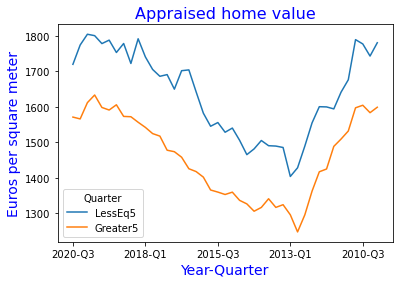

In [28]:
df_homevalue.plot(kind='line')
plt.xlabel('Year-Quarter', fontsize=14, color='blue')
plt.ylabel('Euros per square meter', fontsize=14, color='blue')
plt.title('Appraised home value', fontsize=16, color='blue')


In [34]:
# Finally, we want to get an estimate of the revenue that a guest room can generate
# per month to obtain a rough idea of when the high and low seasons are for tourism.
# Again, this data was downloaded, translated and saved on CSV format.
# Data was only available to three municipalities: 
# Mogan, Las Palmas and S. Bartolome de Tirajana.
tourismIncome = pd.read_csv('IncomePerAvailableGuestroomPrueba.csv')
tourismIncome.head()

,Municipality,Year,Month,Income
0,Mogan,2020,January,83.89
1,Mogan,2020,February,88.34
2,Mogan,2020,March,40.50
3,Mogan,2020,April,NaN
4,Mogan,2020,May,NaN


In [42]:
# The dataframe will be splitted per municipality.
incomeMogan = tourismIncome.loc[tourismIncome['Municipality'] == 'Mogan']
incomeLasPalmas = tourismIncome.loc[tourismIncome['Municipality'] == 'Las Palmas de Gran Canaria']
incomeSanBartolome = tourismIncome.loc[tourismIncome['Municipality'] == 'San Bartolome de Tirajana']

Text(0.5, 1.0, 'Mogan')

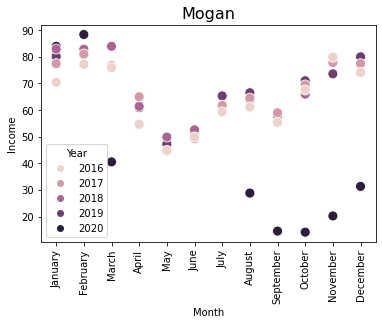

In [57]:
# Scatter plot for Mogan:
sns.scatterplot(data=incomeMogan, x='Month', y='Income', s=100, hue='Year')
plt.xticks(rotation=90)
plt.title('Mogan', size = 16)

Text(0.5, 1.0, 'Las Palmas de Gran Canaria')

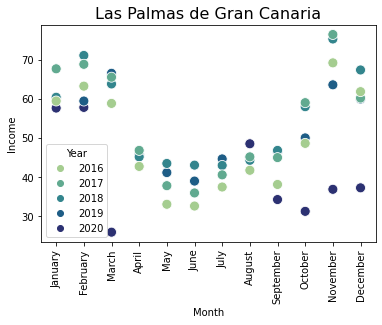

In [58]:
# Scatter plot for Las Palmas:
sns.scatterplot(data=incomeLasPalmas, x='Month', y='Income', s=100, hue='Year', palette='crest')
plt.xticks(rotation=90)
plt.title('Las Palmas de Gran Canaria', size = 16)

Text(0.5, 1.0, 'San Bartolome de Tirajana')

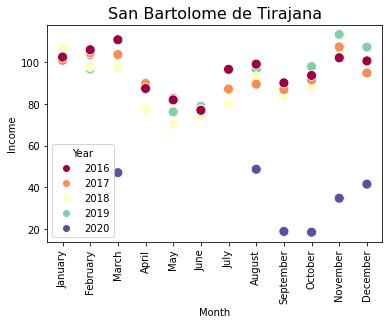

In [59]:
# Scatter plot for San Bartolome:
sns.scatterplot(data=incomeSanBartolome, x='Month', y='Income', s=100, hue='Year', palette='Spectral')
plt.xticks(rotation=90)
plt.title('San Bartolome de Tirajana', size = 16)

# ------------------------ End of Assignment ------------------------ 